# Transfer Learning for Possum Detection

In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as Fun
import torch.optim as optim
from torch.optim import lr_scheduler
import torchvision
from torchvision.models import resnet18, ResNet18_Weights
from torchvision import datasets, models, transforms
from torchvision.transforms import functional as F
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, precision_score, recall_score, roc_auc_score, roc_curve,accuracy_score 
import copy
import pandas as pd

Check if a GPU with CUDA is available; used to decide whether to run the model on GPU or CPU

In [2]:
torch.cuda.is_available()

True

In [3]:
device = "cuda" if torch.cuda.is_available() else "cpu"

## Data Preparation: load and transform the dataset into tensors

Our pretrained model, ResNet18, expects an input size of 224x224.  
Therefore, we need to resize and crop the images.  

However, our crops/ROIs are already tightly cropped, often stretched horizontally or vertically.  
We cannot risk further cropping and losing important possum details.  

To address this, we define the following function `ResizeWithPadding`, which resizes the image while preserving the aspect ratio and pads the shorter side to make it square.


In [4]:
class ResizeWithPadding:
    def __init__(self, size=224, fill=0):
        self.size = size
        self.fill = fill

    def __call__(self, img):
        # Original image size
        w, h = img.size

        # Compute scale factor so that the larger side becomes `size`
        scale = self.size / max(w, h)

        # Compute new size while preserving aspect ratio
        new_w, new_h = int(w * scale), int(h * scale)

        # Resize image
        img = F.resize(img, (new_h, new_w))

        # Compute required padding to reach (size x size)
        pad_w = self.size - new_w
        pad_h = self.size - new_h

        # Distribute padding equally on both sides
        padding = (
            pad_w // 2,                 # left
            pad_h // 2,                 # top
            pad_w - pad_w // 2,         # right
            pad_h - pad_h // 2          # bottom
        )

        # Apply padding
        return F.pad(img, padding, fill=self.fill)

We define the data transformations for our training and testing datasets.  

The pretrained ResNet18 model expects input images to be normalized with the following mean and standard deviation values:

- Mean: `[0.485, 0.456, 0.406]`
- Standard deviation: `[0.229, 0.224, 0.225]`

For the training dataset, we also apply **data augmentation** to improve model generalization:

- `RandomHorizontalFlip(p=0.3)`: randomly flips images horizontally with a 30% probability.  
- `RandomApply([ColorJitter(brightness=0.2, contrast=0.2)], p=0.3)`: randomly adjusts brightness and contrast for 30% of the images.  

For the testing dataset, we only apply the `ResizeWithPadding`, conversion to tensor, and normalization, without augmentation, to evaluate the model on original data.


In [5]:
# Normalization parameters required by pretrained ResNet18
mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]

# Transformations for training dataset
train_transform = transforms.Compose([
    ResizeWithPadding(224),
    transforms.RandomHorizontalFlip(p=0.3),
    transforms.RandomApply([
        transforms.ColorJitter(brightness=0.2, contrast=0.2)
    ], p=0.3),
    transforms.ToTensor(),
    transforms.Normalize(mean, std)
])

# Transformations for testing dataset
test_transform = transforms.Compose([
ResizeWithPadding(224),
transforms.ToTensor(),
transforms.Normalize(mean, std)])

# Transformations for validating dataset
val_transform = transforms.Compose([
    ResizeWithPadding(224),
    transforms.ToTensor(),
    transforms.Normalize(mean, std)
])

We load the training and testing datasets using `ImageFolder` and apply the transformations defined earlier (`train_transform` and `test_transform`).  
This organizes the data into PyTorch datasets that are ready to be wrapped in `DataLoader` for training and evaluation.


In [6]:
 # Root directory containing 'train' and 'test' folders
data_dir = 'crops/choice'
images ={}
# Load training dataset with data augmentation and normalization
images['train']= datasets.ImageFolder(data_dir + '/train', train_transform)
# Load testing dataset with only resizing and normalization
images['test']= datasets.ImageFolder(data_dir + '/test', test_transform)
# Load validation dataset with only resizing and normalization
images['val']= datasets.ImageFolder(data_dir + '/validation', val_transform)

print(f"Training data size - {len(images['train'])}")
print(f"Test data size - {len(images['test'])}")
print(f"Validation data size - {len(images['val'])}")


Training data size - 22875
Test data size - 5295
Validation data size - 5192


In [7]:
class_names = images['train'].classes
class_names

['not_possums', 'possums']

In [8]:
images['train'].class_to_idx

{'not_possums': 0, 'possums': 1}

In [9]:
images

{'train': Dataset ImageFolder
     Number of datapoints: 22875
     Root location: crops/choice/train
     StandardTransform
 Transform: Compose(
                RandomHorizontalFlip(p=0.3)
                RandomApply(
                p=0.3
                ColorJitter(brightness=(0.8, 1.2), contrast=(0.8, 1.2), saturation=None, hue=None)
            )
                ToTensor()
                Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
            ),
 'test': Dataset ImageFolder
     Number of datapoints: 5295
     Root location: crops/choice/test
     StandardTransform
 Transform: Compose(
                ToTensor()
                Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
            ),
 'val': Dataset ImageFolder
     Number of datapoints: 5192
     Root location: crops/choice/validation
     StandardTransform
 Transform: Compose(
                ToTensor()
                Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
 

We create PyTorch `DataLoader` objects for the training and testing datasets.  
The `DataLoader` handles batching, shuffling, and efficient data loading during model training and evaluation.

For the training set, shuffling is enabled to randomize the order of samples and improve generalization.  
The test set is also loaded in batches of the same size to ensure consistent evaluation.

In [10]:
dataloaders ={}
dataloaders['train'] = torch.utils.data.DataLoader(images['train'],
batch_size=8,
shuffle=True,
num_workers=0)

dataloaders['test'] = torch.utils.data.DataLoader(images['test'],
batch_size=8,
shuffle=True,
num_workers=0)

dataloaders['val'] = torch.utils.data.DataLoader(images['val'],
batch_size=8,
shuffle=True,
num_workers=0)

dataloaders

{'train': <torch.utils.data.dataloader.DataLoader at 0x2104e4e1720>,
 'test': <torch.utils.data.dataloader.DataLoader at 0x2104e4e3ac0>,
 'val': <torch.utils.data.dataloader.DataLoader at 0x2104e4e2ec0>}

Examine the shape

In [18]:
inputs, labels = next(iter(dataloaders['train']))
inputs.shape


torch.Size([8, 3, 224, 224])

In [19]:
labels


tensor([0, 0, 0, 1, 0, 1, 0, 1])

We use `make_grid` to combine a batch of images into a single grid for visualization.  
This helps inspect multiple input samples at once and verify that preprocessing and transformations were applied correctly.

In [20]:
inp = torchvision.utils.make_grid(inputs)
inp.shape


torch.Size([3, 228, 1810])

In [21]:
inp.max()


tensor(2.6400)

After normalization, pixel values can fall outside the [0, 1] range.  
Before visualization, we clip the tensor values to the [0, 1] range to ensure correct RGB display.

In [22]:
np.clip(inp, 0, 1).max()


tensor(1.)

 Plot the image grid

In [23]:
inp.numpy().transpose((1, 2, 0)).shape


(228, 1810, 3)

We define a helper function to visualize a batch of images.  
The function converts the tensor to a NumPy array, restores the original image values by reversing normalization, and clips them to the valid [0, 1] range for display.

This allows us to visually inspect the input images and verify that preprocessing and labels are correct.


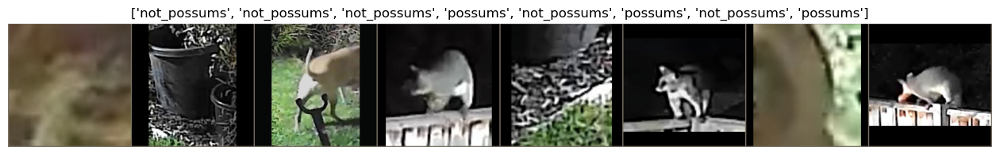

In [24]:
plt.ion()
def img_show(inp, title=None):

    inp = inp.numpy().transpose((1, 2, 0))
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)

    plt.figure(figsize=(16,4))
    plt.axis('off')
    plt.imshow(inp)

    if title is not None:
        plt.title(title)  

img_show(inp, title=[class_names[x] for x in labels])

## Training the Transfer Learning Model

We initialize a pretrained ResNet18 model.  
The model was trained on ImageNet and provides a strong feature extractor for our task.

We then retrieve the number of input features of the final fully connected layer.  
This value is needed to replace the classifier head so it matches the number of classes in our possum detection task.


### Frozen Feature Extractor (Baseline)

I started with a transfer learning approach using a pretrained ResNet18 as a **fixed feature extractor**.  
All convolutional layers were frozen, and only the final fully connected layer was replaced and trained for the binary possum detection task.

The goal of this experiment was to:

- Establish a strong and stable baseline model  
- Evaluate how well pretrained ImageNet features generalise to wildlife detection  
- Reduce overfitting risk by limiting the number of trainable parameters  
- Compare this approach later against full fine-tuning  

By freezing the backbone, the model leverages robust pretrained visual representations while keeping training computationally efficient.

In [25]:
weights = ResNet18_Weights.DEFAULT
frozen_model = resnet18(weights=weights)
num_ftrs = frozen_model.fc.in_features
num_ftrs

512

In [26]:

for param in frozen_model.parameters():
    param.requires_grad = False
    
#We add the final layer which is not frozen
frozen_model.fc = nn.Linear(num_ftrs, 2)

#Add an optimizer - for only the final layer
optimizer = optim.SGD(frozen_model.fc.parameters(),
lr=0.001,
momentum=0.9) 

exp_lr_scheduler = lr_scheduler.StepLR(optimizer,
step_size=7,
gamma=0.1)

criterion = nn.CrossEntropyLoss()

# Move model and loss function to the selected device (CPU or GPU)
frozen_model = frozen_model.to(device)
criterion = criterion.to(device)

This helper function computes and reports the loss and accuracy for a single epoch.  
The metrics are calculated over the entire dataset for the given phase (training or testing) and are used to monitor model performance during training


In [27]:
def calculate_accuracy(phase, running_loss, running_corrects):
    # Compute average loss for the epoch
    epoch_loss = running_loss / len(images[phase])
    
    # Compute accuracy for the epoch
    # Convert to float to avoid integer division and obtain a fractional accuracy value
    epoch_acc = (running_corrects.double() / len(images[phase])).item()

    print('{} Loss: {:.4f} Acc: {:.4f}'.format( phase, epoch_loss, epoch_acc))

    return (epoch_loss, epoch_acc)

This function performs one training phase (one epoch) on the training dataset.  
It iterates over all batches, computes predictions, calculates the loss, performs backpropagation, and updates model weights.  
At the end, it calculates and prints the training loss and accuracy for the epoch.


In [28]:
def phase_train(model, criterion, optimizer):
    # Set model to training mode (enables dropout, batchnorm, etc.)
    model.train()
    running_loss = 0.0
    running_corrects = 0

    # Iterate over training batches
    for inputs, labels in dataloaders['train']:
        inputs = inputs.to(device)
        labels = labels.to(device)

        # Clear previous gradients
        optimizer.zero_grad()

        # Enable gradient calculation
        with torch.set_grad_enabled(True):
             # Forward pass
            outputs = model(inputs)
            # Get predicted class indices
            _, preds = torch.max(outputs, 1)
            # Compute loss
            loss = criterion(outputs, labels)

            # Backpropagation
            loss.backward()
            # Update weights
            optimizer.step()

        # Accumulate loss and correct predictions
        running_loss += loss.item() * inputs.size(0)
        running_corrects += torch.sum(preds == labels)
        
    # Compute and print epoch loss and accuracy
    epoch_loss, epoch_acc = calculate_accuracy('train', running_loss, running_corrects) 
    return(epoch_loss, epoch_acc)

This function evaluates the model on the test/validation dataset.  

It computes the loss and accuracy for the entire dataset without updating model weights.  
The model is set to evaluation mode, and gradient calculations are disabled.  

We track the best-performing modeby **lowest validationoss**.  
The function returns a copy of the model weights corresponding to this best loss.


In [29]:
def phase_val(model, criterion):
    # Set model to evaluation mode (disables dropout, batchnorm updates)
    model.eval()
    running_loss = 0.0
    running_corrects = 0

    # Iterate over test/validation batches
    for inputs, labels in dataloaders['val']:

        inputs = inputs.to(device)
        labels = labels.to(device)

        with torch.no_grad():
            outputs = model(inputs) # Forward pass
            _, preds = torch.max(outputs, 1) # Get predicted class indices
            loss = criterion(outputs, labels)  # Compute loss

         # Accumulate loss and correct predictions
        running_loss += loss.item() * inputs.size(0)
        running_corrects += torch.sum(preds == labels)
    
    # Compute epoch loss and accuracy
    epoch_loss, epoch_acc = calculate_accuracy('val', running_loss, running_corrects)

    return epoch_loss, epoch_acc

This function orchestrates the full training process of the model over multiple epochs.  

For each epoch, it performs:
1. A training phase (`phase_train`) where model weights are updated.
2. A testing/validation phase (`phvaltest`) to evaluate performance without updating weights.

The learning rate scheduler is stepped at the end of each epoch.  
The function tracks and restores the best model weights based on validation loss (or accuracy).  
Finally, it returns the trained model ready for inference or further evaluation.


In [30]:
def phase_val(model, criterion):
    # Set model to evaluation mode (disables dropout, batchnorm updates)
    model.eval()
    running_loss = 0.0
    running_corrects = 0

    # Iterate over test/validation batches
    for inputs, labels in dataloaders['val']:

        inputs = inputs.to(device)
        labels = labels.to(device)

        with torch.no_grad():
            outputs = model(inputs) # Forward pass
            _, preds = torch.max(outputs, 1) # Get predicted class indices
            loss = criterion(outputs, labels)  # Compute loss

         # Accumulate loss and correct predictions
        running_loss += loss.item() * inputs.size(0)
        running_corrects += torch.sum(preds == labels)
    
    # Compute epoch loss and accuracy
    epoch_loss, epoch_acc = calculate_accuracy('val', running_loss, running_corrects)

    return epoch_loss, epoch_acc

In [31]:
def build_model(model, criterion, optimizer, scheduler, num_epochs=10, patience=3):
    # Store initial model weights to keep track of the best model
    best_model_wts = copy.deepcopy(model.state_dict())
    best_loss = float('inf')
    early_stop_counter = 0
    train_losses = []
    train_accs = []
    val_losses = []
    val_accs = []
    
    # Loop over epochs
    for epoch in range(num_epochs):

        print(f'Epoch {epoch+1}/{num_epochs}')
        print('-' * 10)

        # Training phase: update model weights
        train_loss, train_acc = phase_train(model, criterion, optimizer)
        train_losses.append(train_loss)
        train_accs.append(train_acc)

        # Testing/validation phase: evaluate model and update best weights
        val_loss, val_acc = phase_val(model, criterion)     
        val_losses.append(val_loss)
        val_accs.append(val_acc)

        # Check improvements
        if val_loss < best_loss:
            best_loss = val_loss
            best_model_wts = copy.deepcopy(model.state_dict())
            early_stop_counter = 0
            print("Validation improved → saving model")

        else:
            early_stop_counter += 1
            print(f"No improvement → Early stop counter: {early_stop_counter}/{patience}")

        # Early stopping
        if early_stop_counter >= patience:
            print("Early stopping triggered")
            break

        scheduler.step()
        print()

    print(f'Best validation loss: {best_loss:.4f}')

    model.load_state_dict(best_model_wts)

    return model, train_losses, train_accs, val_losses, val_accs

We start the training process by calling `build_model` with the initialized model, loss function, optimizer, and learning rate scheduler.  
The model will train for 5 epochs, alternating between training and validation phases, and will keep the best weights based on validation loss.

In [32]:
print(inputs.shape, labels.shape, labels.dtype)
print(labels.min(), labels.max())

torch.Size([8, 3, 224, 224]) torch.Size([8]) torch.int64
tensor(0) tensor(1)


In [33]:
frozen_model, train_losses, train_accs, val_losses, val_accs = build_model(frozen_model,
criterion,
optimizer,
exp_lr_scheduler,
num_epochs=10) 

Epoch 1/10
----------
train Loss: 0.2598 Acc: 0.8948
val Loss: 0.1548 Acc: 0.9337
Validation improved → saving model

Epoch 2/10
----------
train Loss: 0.2331 Acc: 0.9090
val Loss: 0.1341 Acc: 0.9495
Validation improved → saving model

Epoch 3/10
----------
train Loss: 0.2280 Acc: 0.9107
val Loss: 0.1667 Acc: 0.9353
No improvement → Early stop counter: 1/3

Epoch 4/10
----------
train Loss: 0.2212 Acc: 0.9137
val Loss: 0.1297 Acc: 0.9468
Validation improved → saving model

Epoch 5/10
----------
train Loss: 0.2149 Acc: 0.9170
val Loss: 0.1288 Acc: 0.9520
Validation improved → saving model

Epoch 6/10
----------
train Loss: 0.2234 Acc: 0.9150
val Loss: 0.1076 Acc: 0.9613
Validation improved → saving model

Epoch 7/10
----------
train Loss: 0.2159 Acc: 0.9184
val Loss: 0.1942 Acc: 0.9262
No improvement → Early stop counter: 1/3

Epoch 8/10
----------
train Loss: 0.1822 Acc: 0.9290
val Loss: 0.1456 Acc: 0.9413
No improvement → Early stop counter: 2/3

Epoch 9/10
----------
train Loss: 0.17

In [34]:
def loss_visualisation(train_loss, val_loss, train_acc, val_acc):
    history_df = pd.DataFrame({
        "epoch": range(1, len(train_losses) + 1),
        "train_loss": train_losses,
        "val_loss": val_losses,
        "train_acc": train_accs,
        "val_acc": val_accs
    })
    
    print(history_df)
    
    sns.set_theme(style="whitegrid", context="talk")
    fig, axes = plt.subplots(1, 2, figsize=(16,6))
    
    sns.lineplot(ax=axes[0], data=history_df, x="epoch", y="train_loss", color="coral", marker="o", linewidth=2, label="Train")
    sns.lineplot(ax=axes[0], data=history_df, x="epoch", y="val_loss", color="skyblue", marker="o", linewidth=2,  label="Validation")
    axes[0].set_title("Loss")
    
    sns.lineplot(ax=axes[1], data=history_df, x="epoch", y="train_acc", color="coral", marker="o", linewidth=2, label="Train")
    sns.lineplot(ax=axes[1], data=history_df, x="epoch", y="val_acc", color="skyblue", marker="o", linewidth=2, label="Validation")
    axes[1].set_title("Accuracy")
    
    plt.tight_layout()
    plt.show()

   epoch  train_loss  val_loss  train_acc   val_acc
0      1    0.259825  0.154788   0.894820  0.933744
1      2    0.233103  0.134094   0.908984  0.949538
2      3    0.227980  0.166738   0.910732  0.935285
3      4    0.221203  0.129732   0.913661  0.946841
4      5    0.214879  0.128822   0.916984  0.952042
5      6    0.223430  0.107641   0.914973  0.961287
6      7    0.215896  0.194232   0.918383  0.926233
7      8    0.182158  0.145565   0.928962  0.941256
8      9    0.175574  0.149861   0.932372  0.937596


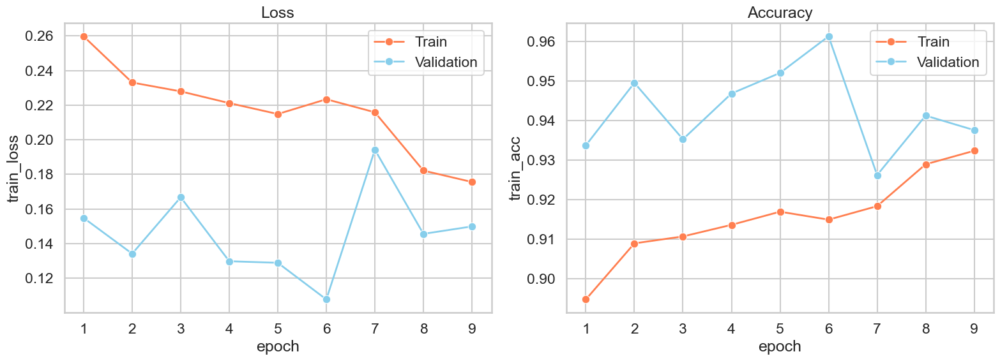

In [35]:
loss_visualisation(train_losses, val_losses, train_accs, val_accs)

We evaluate the trained model on the entire test dataset to collect predictions and identify misclassified samples.
The model is set to evaluation mode with gradients disabled to speed up inference.
We store true labels and predicted labels for metric calculation, and also keep misclassified images along with their true and predicted class labels for inspection.
We calculate recall and precision for the test dataset.
Recall measures the proportion of actual positives correctly identified by the model- .
Precision measures the proportion of positive predictions that are actually correct.
These metrics together give a better understanding of the model's performance.
We compute and visualize the confusion matrix for the test dataset.
The confusion matrix shows the number of correct and incorrect predictions for each class, providing insight into model performance.
A color map is displayed to make misclassifications easier to spot.

This block also visualizes a few test images along with the model's predictions.  
We disable gradient computation using `torch.no_grad()` since we are only performing inference.  
A batch of test images is retrieved, sent to the device, and passed through the trained model.  
Predicted class labels are extracted, and each image is displayed using the `img_show` function.


In [36]:
def evaluate_model(model, dataloader, class_names, device, num_images=6):

    model.eval()

    y_true = []
    y_pred = []
    y_prob = []
    misclassified = []

    with torch.no_grad():

        # Full dataset evaluation
        for inputs, labels in dataloader:

            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            probs = Fun.softmax(outputs, dim=1)

            y_true.extend(labels.cpu().numpy())
            y_pred.extend(preds.cpu().numpy())
            y_prob.extend(probs[:, 1].cpu().numpy())

            for j in range(inputs.size(0)):
                if preds[j] != labels[j]:
                    misclassified.append({
                        "image": inputs[j].cpu(),
                        "true_label": class_names[labels[j].item()],
                        "pred_label": class_names[preds[j].item()]
                    })

    # Metrics
    accuracy = accuracy_score(y_true, y_pred)
    roc_auc = roc_auc_score(y_true, y_prob)

    print(f"\nAccuracy: {accuracy:.4f}")
    print(f"ROC AUC: {roc_auc:.4f}")

    # Precision / Recall /
    rec_score = recall_score(y_true, y_pred)
    print(f"\nRecall score: {rec_score:.4f}")
    precis_score = precision_score(y_true, y_pred)
    print(f"Precision_score: {precis_score:.4f}")
    
    # ---- Confusion Matrix ----
    cm = confusion_matrix(y_true, y_pred)
    print('\n Confusion matrix:')
    print(cm)

    sns.set_theme(style="white")
    plt.figure(figsize=(6,5))

    sns.heatmap(
        cm,
        annot=True,
        fmt="d",
        cmap="Greens",
        xticklabels=class_names,
        yticklabels=class_names
    )

    plt.xlabel("Predicted")
    plt.ylabel("Actual")
    plt.title("Confusion Matrix")
    plt.show

    
    fpr, tpr, _ = roc_curve(y_true, y_prob)
    plt.figure(figsize=(6,5))
    plt.plot(fpr, tpr)
    plt.plot([0,1], [0,1], linestyle="--")
    
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.title("ROC Curve")
    
    plt.show()


    return {
        "accuracy": accuracy,
        "roc_auc": roc_auc,
        "confusion_matrix": cm,
        "misclassified": misclassified
    }


Accuracy: 0.9224
ROC AUC: 0.9758

Recall score: 0.8928
Precision_score: 0.9322

 Confusion matrix:
[[2753  155]
 [ 256 2131]]


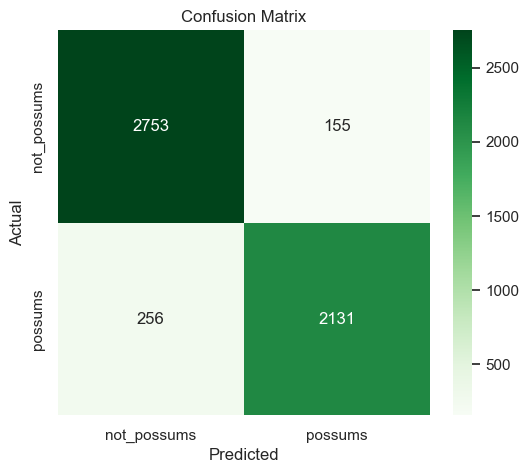

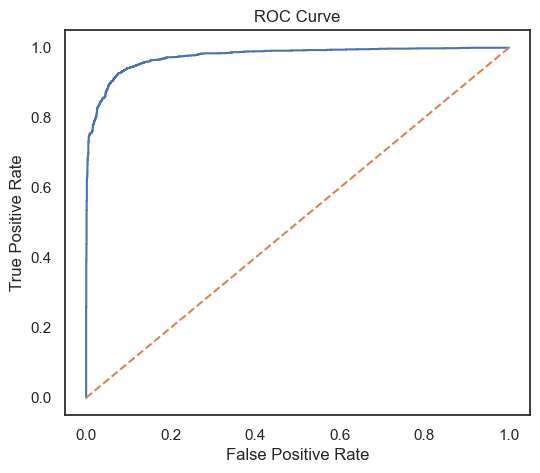

In [37]:
frozen_metrics = evaluate_model(frozen_model, dataloaders['test'], class_names, device, num_images=6)

In [38]:
images['test'].class_to_idx

{'not_possums': 0, 'possums': 1}

In [39]:
class_names

['not_possums', 'possums']

We visualize the misclassified test images to understand where the model makes errors.  

For each misclassified sample, the image is displayed along with its predicted label.  
This helps identify patterns in mistakes and can guide further improvements in data preprocessing or model training.


C:\Users\Home\AppData\Local\Temp\ipykernel_13424\2324432509.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(16,4))


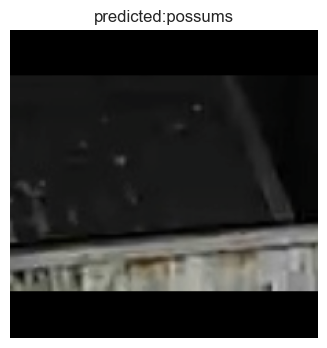

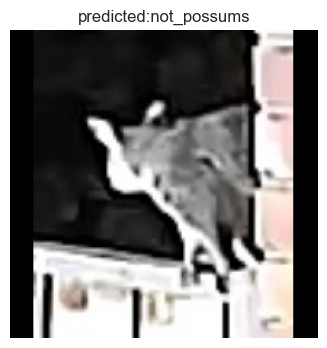

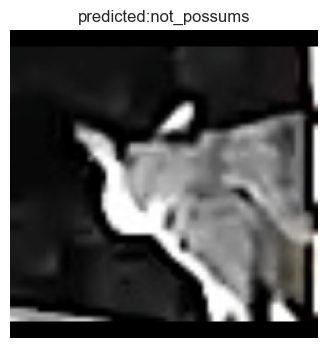

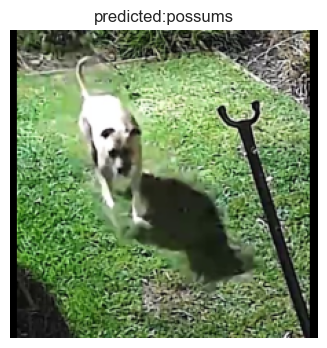

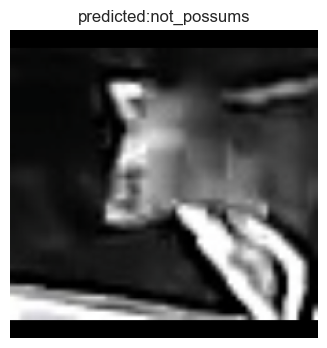

...

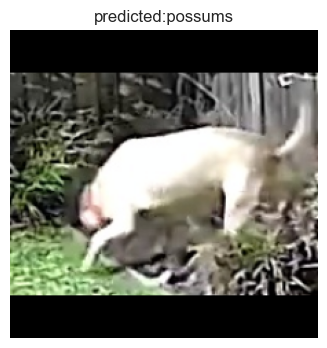

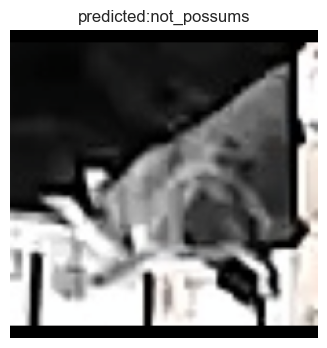

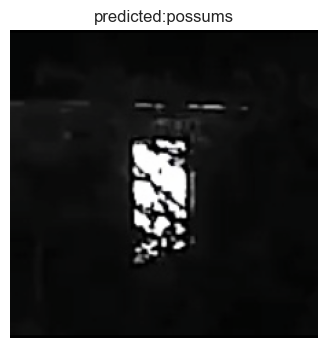

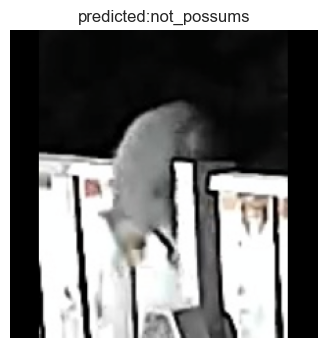

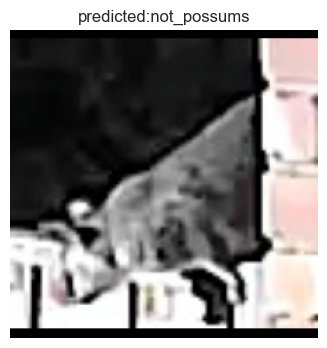

In [40]:
for i, item in enumerate(frozen_metrics["misclassified"]):
    inp = item['image']
    img_show(inp, 'predicted:' + item['pred_label'])

We save the trained PyTorch model to a file named `'tf_model'`.  

This allows the model to be reloaded later for inference or further training without retraining from scratch.


In [41]:
torch.save(frozen_model, 'frozen_tf_model')
torch.save(frozen_model.state_dict(), "frozen_tf_model_weights.pth")

### Full Fine-Tuning Approach

After establishing a frozen feature extractor baseline, the next step is to evaluate a full fine-tuning strategy.

In this approach, the final classification layer is replaced to match the binary possum detection task, and all model parameters are allowed to update during training. This enables the pretrained ResNet18 to adapt its internal feature representations specifically to wildlife activity patterns.

The objective of this experiment is to:

- Assess whether allowing the entire network to learn improves performance  
- Capture domain-specific visual features related to possum behaviour and environment  
- Compare performance against the frozen baseline model  

This experiment helps determine whether additional model flexibility leads to better generalisation and detection accuracy.

In [42]:
weights = ResNet18_Weights.DEFAULT
full_model = resnet18(weights=weights)
num_ftrs = full_model.fc.in_features

In [43]:
# Replace the final classification layer to output 2 classes
full_model.fc = nn.Linear(num_ftrs, 2)
# Define the loss function for classification
criterion = nn.CrossEntropyLoss()
 
# Define the optimizer (Stochastic Gradient Descent)
optimizer = optim.SGD(
    full_model.parameters(),   # Parameters to optimize
    lr=0.001,              # Learning rate
    momentum=0.9           # Momentum for faster convergence
)

# Learning rate scheduler: reduce LR by a factor of 0.1 every 7 epochs
exp_lr_scheduler = lr_scheduler.StepLR(optimizer,
step_size=7,
gamma=0.1)

# Move model and loss function to the selected device (CPU or GPU)
full_model = full_model.to(device)
criterion = criterion.to(device)

In [44]:
full_model, train_losses, train_accs, val_losses, val_accs = build_model(full_model,
criterion,
optimizer,
exp_lr_scheduler,
num_epochs=10)

Epoch 1/10
----------
train Loss: 0.0804 Acc: 0.9724
val Loss: 0.0478 Acc: 0.9836
Validation improved → saving model

Epoch 2/10
----------
train Loss: 0.0256 Acc: 0.9929
val Loss: 0.0251 Acc: 0.9917
Validation improved → saving model

Epoch 3/10
----------
train Loss: 0.0100 Acc: 0.9974
val Loss: 0.0248 Acc: 0.9938
Validation improved → saving model

Epoch 4/10
----------
train Loss: 0.0078 Acc: 0.9980
val Loss: 0.0159 Acc: 0.9965
Validation improved → saving model

Epoch 5/10
----------
train Loss: 0.0108 Acc: 0.9972
val Loss: 0.0124 Acc: 0.9979
Validation improved → saving model

Epoch 6/10
----------
train Loss: 0.0079 Acc: 0.9986
val Loss: 0.0168 Acc: 0.9936
No improvement → Early stop counter: 1/3

Epoch 7/10
----------
train Loss: 0.0128 Acc: 0.9976
val Loss: 0.0224 Acc: 0.9961
No improvement → Early stop counter: 2/3

Epoch 8/10
----------
train Loss: 0.0043 Acc: 0.9990
val Loss: 0.0194 Acc: 0.9969
No improvement → Early stop counter: 3/3
Early stopping triggered
Best validatio

   epoch  train_loss  val_loss  train_acc   val_acc
0      1    0.080423  0.047844   0.972415  0.983629
1      2    0.025595  0.025071   0.992874  0.991718
2      3    0.009964  0.024762   0.997421  0.993837
3      4    0.007784  0.015866   0.997989  0.996533
4      5    0.010772  0.012359   0.997246  0.997881
5      6    0.007940  0.016773   0.998601  0.993644
6      7    0.012837  0.022388   0.997552  0.996148
7      8    0.004286  0.019404   0.999038  0.996918


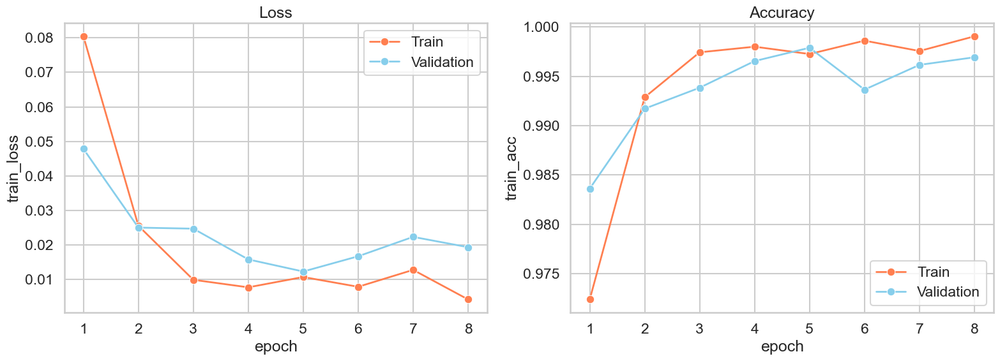

In [45]:
loss_visualisation(train_losses, val_losses, train_accs, val_accs)


Accuracy: 0.9930
ROC AUC: 0.9992

Recall score: 0.9849
Precision_score: 0.9996

 Confusion matrix:
[[2907    1]
 [  36 2351]]


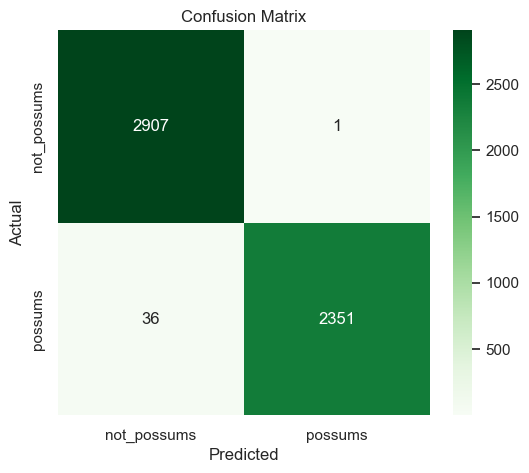

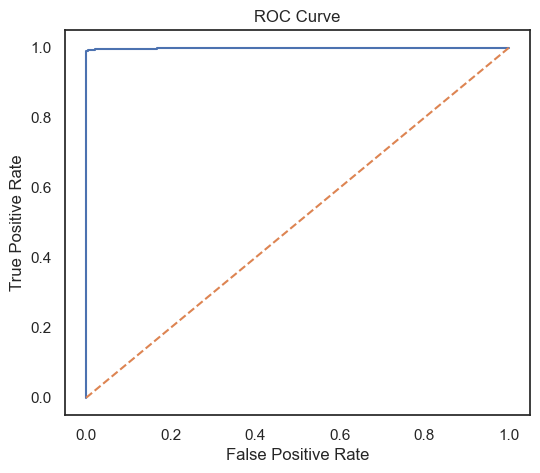

In [46]:
full_metrics = evaluate_model(full_model, dataloaders['test'], class_names, device, num_images=6)

C:\Users\Home\AppData\Local\Temp\ipykernel_13424\2324432509.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(16,4))


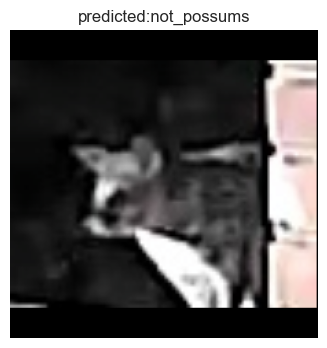

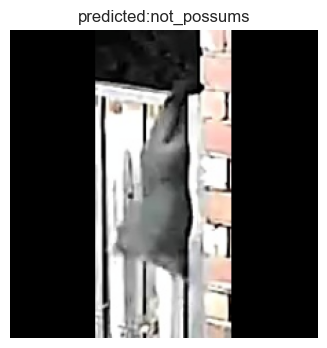

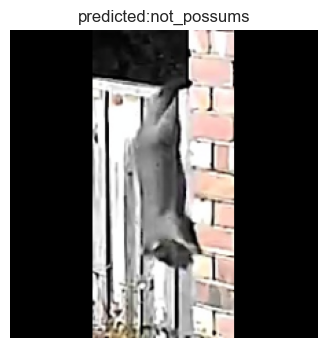

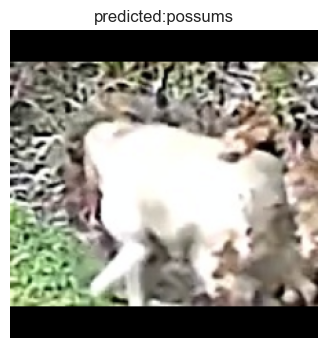

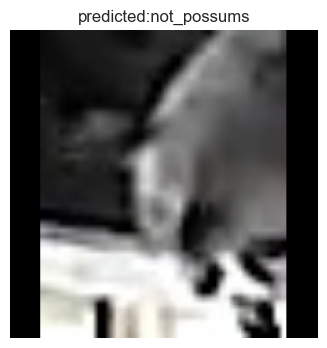

...

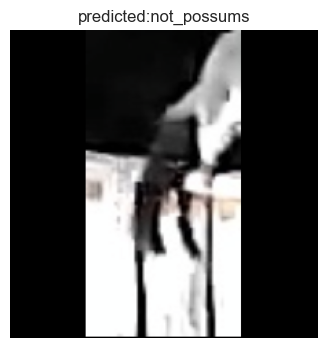

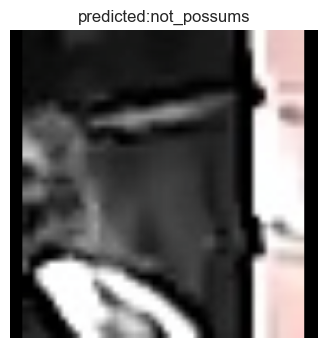

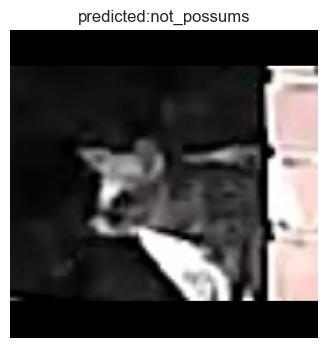

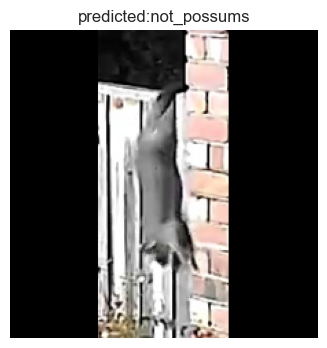

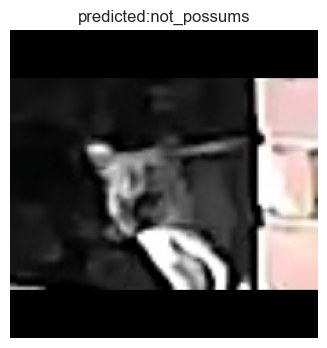

In [48]:
for i, item in enumerate(full_metrics["misclassified"]):
    inp = item['image']
    img_show(inp, 'predicted:' + item['pred_label'])

In [49]:
torch.save(full_model, 'full_model')
torch.save(full_model.state_dict(), "full_model")